<!-- #%% [markdown] -->
# CE639: AI for Civil Engineering
## Lecture 02: Linear Algebra for ML
### Interactive Python Notebook

**Course:** CE639 - AI for Civil Engineering  
**Instructors:** Dr. Udit Bhatia & Dr. Sushobhan Sen  
**Tutor:** Sarth Dubey  
**Institution:** IIT Gandhinagar

---

### Learning Objectives
By the end of this notebook, you will be able to:
- Differentiate between different types of tensors and how they are stored on a computer
- Explain projections, rank, and conditioning
- Define and calculate eigenvalues and singular values
- Apply these concepts to Civil Engineering problems

## 🔧 Setup and Installation

First, let's install required packages and import our helper utilities.

In [ ]:
# Install dependencies (for Google Colab)
import sys
import subprocess

def install_package(package):
    """Install a package using pip."""
    subprocess.check_call([sys.executable, "-m", "pip", "install", "-q", package])

# Check if running in Colab
try:
    import google.colab
    IN_COLAB = True
    print("Running in Google Colab ✓")
except:
    IN_COLAB = False
    print("Running locally ✓")

# Install required packages
required_packages = ['numpy', 'matplotlib', 'ipywidgets', 'pandas']
for package in required_packages:
    try:
        __import__(package)
    except ImportError:
        print(f"Installing {package}...")
        install_package(package)

print("\n✓ All packages installed successfully!")

Running locally ✓


In [ ]:
if IN_COLAB:
    # !git clone https://github.com/dubeysarth/2026_IITGN_CE639
    # %cd 2026_IITGN_CE639
    subprocess.run(['git', 'clone', 'https://github.com/dubeysarth/2026_IITGN_CE639'])
    subprocess.run(['cd', '2026_IITGN_CE639'])

In [2]:
# Import standard libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from IPython.display import display, HTML, Image
import warnings
warnings.filterwarnings('ignore')

# Configure matplotlib
plt.rcParams['figure.dpi'] = 100
plt.rcParams['font.size'] = 10
%matplotlib inline

# Import our custom helper utilities
import sys
sys.path.append('/content')  # For Colab
sys.path.append('..')  # For local

from utils.Lecture_02 import (
    # Visualizations
    plot_vector_2d, plot_vector_3d, plot_matrix_heatmap, plot_norm_unit_balls,
    animate_projection, animate_eigen_transform, plot_svd_compression,
    # Widgets
    vector_scaling_widget, norm_explorer_widget, projection_widget,
    svd_rank_widget, condition_number_widget,
    # CE Examples
    create_stiffness_matrix, create_vibration_system, simulate_structural_modes,
    generate_sensor_data, create_force_decomposition,
    # Numerical
    demonstrate_floating_point, memory_usage_table, condition_number_demo,
    near_singular_demo
)

print("✓ All imports successful!")
print("=" * 70)
print("Ready to explore Linear Algebra for Machine Learning!")
print("=" * 70)

✓ All imports successful!
Ready to explore Linear Algebra for Machine Learning!


# 📊 Section 1: Tensors - The Building Blocks

Tensors are the fundamental data structures in AI/ML. Let's explore them from scalars to higher-order tensors.

## 1.1 Scalars

A **scalar** is a single number. In Python/NumPy, scalars can have different data types:

In [3]:
# Different scalar types
scalar_int = 42
scalar_float = 3.14159
scalar_bool = True
scalar_complex = 3 + 4j

print("Scalar Types:")
print(f"  Integer:   {scalar_int} (type: {type(scalar_int).__name__})")
print(f"  Float:     {scalar_float} (type: {type(scalar_float).__name__})")
print(f"  Boolean:   {scalar_bool} (type: {type(scalar_bool).__name__})")
print(f"  Complex:   {scalar_complex} (type: {type(scalar_complex).__name__})")

# NumPy scalars with explicit dtypes
np_int32 = np.int32(42)
np_float64 = np.float64(3.14159)

print(f"\nNumPy scalars:")
print(f"  int32:     {np_int32} (dtype: {np_int32.dtype})")
print(f"  float64:   {np_float64} (dtype: {np_float64.dtype})")

Scalar Types:
  Integer:   42 (type: int)
  Float:     3.14159 (type: float)
  Boolean:   True (type: bool)
  Complex:   (3+4j) (type: complex)

NumPy scalars:
  int32:     42 (dtype: int32)
  float64:   3.14159 (dtype: float64)


### Why do we care about data types?

Different data types use different amounts of memory and have different precision levels. This affects:
- **Memory usage** for large datasets
- **Computational speed**
- **Numerical precision** and accuracy

## 1.2 Vectors

A **vector** is an ordered collection of scalars, indexed by a single index.

In [4]:
# Create vectors
displacement_vector = np.array([3.5, -2.1, 1.8])  # 3D displacement in meters
force_vector = np.array([1000, 500])  # 2D force in Newtons

print("Vectors:")
print(f"  Displacement (3D): {displacement_vector}")
print(f"  Shape: {displacement_vector.shape}")
print(f"  Dimensions: {displacement_vector.ndim}")
print(f"  Size: {displacement_vector.size}")
print(f"\n  Force (2D): {force_vector}")
print(f"  Shape: {force_vector.shape}")

# Accessing elements
print(f"\nAccessing elements:")
print(f"  displacement_vector[0] = {displacement_vector[0]} m")
print(f"  displacement_vector[1] = {displacement_vector[1]} m")

Vectors:
  Displacement (3D): [ 3.5 -2.1  1.8]
  Shape: (3,)
  Dimensions: 1
  Size: 3

  Force (2D): [1000  500]
  Shape: (2,)

Accessing elements:
  displacement_vector[0] = 3.5 m
  displacement_vector[1] = -2.1 m


### Vector Operations

In [5]:
# Vector operations
v1 = np.array([1, 2, 3])
v2 = np.array([4, 5, 6])

print("Vector Operations:")
print(f"  v1 = {v1}")
print(f"  v2 = {v2}")
print(f"\n  Addition (v1 + v2):        {v1 + v2}")
print(f"  Scalar multiplication (2*v1): {2 * v1}")
print(f"  Element-wise product (v1 * v2): {v1 * v2}")
print(f"  Dot product (v1 · v2):     {np.dot(v1, v2)}")
print(f"  L2 norm (||v1||):          {np.linalg.norm(v1):.3f}")

Vector Operations:
  v1 = [1 2 3]
  v2 = [4 5 6]

  Addition (v1 + v2):        [5 7 9]
  Scalar multiplication (2*v1): [2 4 6]
  Element-wise product (v1 * v2): [ 4 10 18]
  Dot product (v1 · v2):     32
  L2 norm (||v1||):          3.742


### 🎯 CE Example: Displacement Vector

Let's visualize a displacement vector in 2D and 3D:

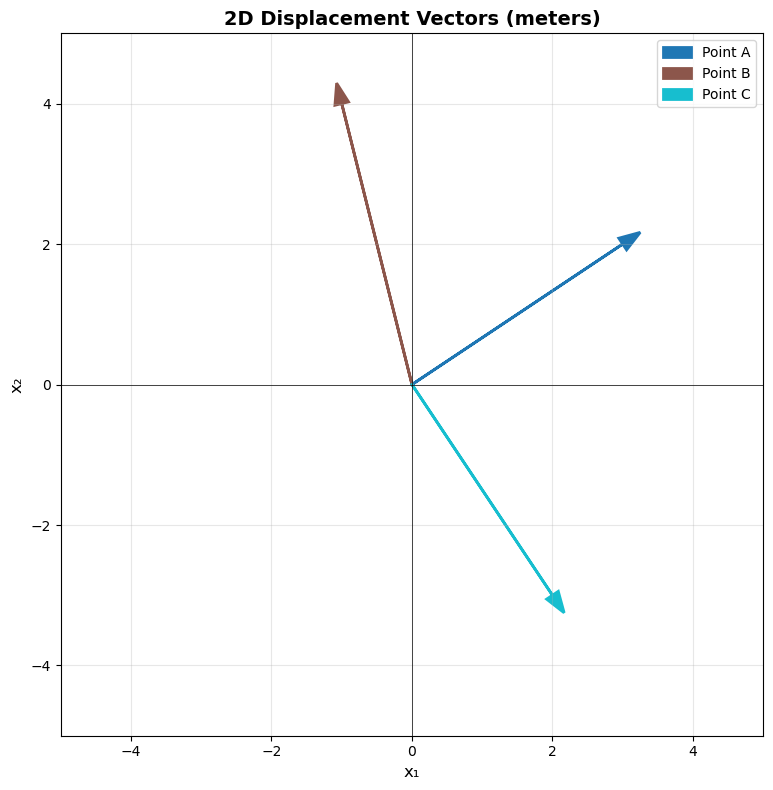

In [6]:
# 2D displacement vectors
displacements_2d = [
    np.array([3, 2]),
    np.array([-1, 4]),
    np.array([2, -3])
]
labels_2d = ['Point A', 'Point B', 'Point C']

fig, ax = plot_vector_2d(displacements_2d, labels=labels_2d, 
                         title="2D Displacement Vectors (meters)")
plt.show()

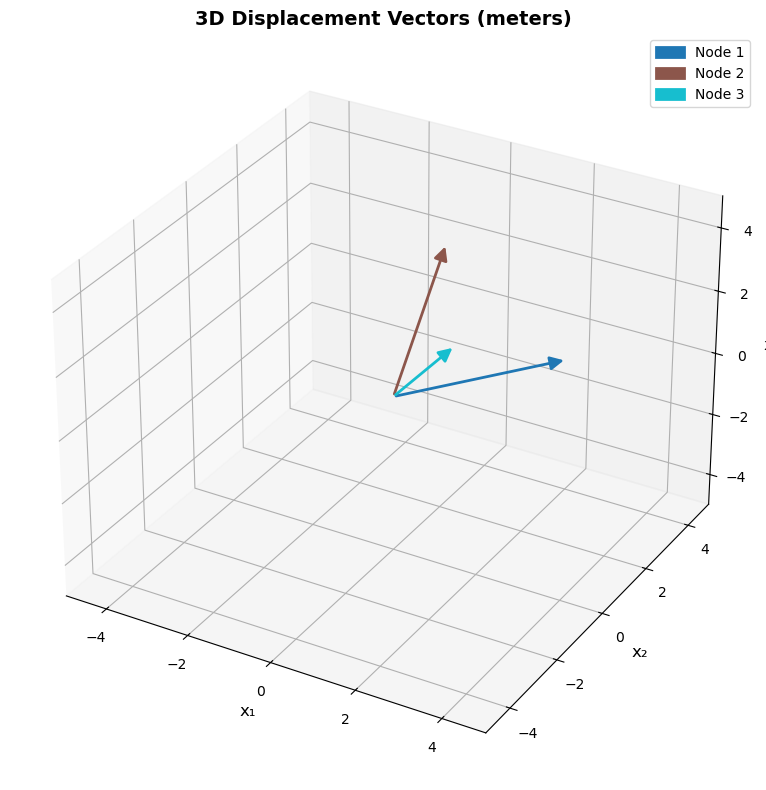

In [7]:
# 3D displacement vectors
displacements_3d = [
    np.array([3, 2, 1]),
    np.array([-1, 4, 2]),
    np.array([2, -1, 3])
]
labels_3d = ['Node 1', 'Node 2', 'Node 3']

fig, ax = plot_vector_3d(displacements_3d, labels=labels_3d,
                         title="3D Displacement Vectors (meters)")
plt.show()

## 1.3 Matrices

A **matrix** is a 2D array of numbers, indexed by two indices (row and column).

In [8]:
# Create matrices
A = np.array([[1, 2, 3],
              [4, 5, 6],
              [7, 8, 9]])

print("Matrix A:")
print(A)
print(f"Shape: {A.shape} (3 rows × 3 columns)")
print(f"Element at [1,2]: {A[1, 2]}")

# Special matrices
I = np.eye(3)  # Identity matrix
Z = np.zeros((3, 3))  # Zero matrix
D = np.diag([1, 2, 3])  # Diagonal matrix

print("\nSpecial Matrices:")
print("Identity Matrix (I):")
print(I)
print("\nDiagonal Matrix (D):")
print(D)

Matrix A:
[[1 2 3]
 [4 5 6]
 [7 8 9]]
Shape: (3, 3) (3 rows × 3 columns)
Element at [1,2]: 6

Special Matrices:
Identity Matrix (I):
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]]

Diagonal Matrix (D):
[[1 0 0]
 [0 2 0]
 [0 0 3]]


### Matrix Operations

In [9]:
# Matrix operations
A = np.array([[1, 2], [3, 4]])
B = np.array([[5, 6], [7, 8]])
v = np.array([1, 2])

print("Matrix Operations:")
print(f"A =\n{A}\n")
print(f"B =\n{B}\n")
print(f"v = {v}\n")

print(f"A + B =\n{A + B}\n")
print(f"A @ B (matrix multiplication) =\n{A @ B}\n")
print(f"A @ v (matrix-vector product) = {A @ v}\n")
print(f"A.T (transpose) =\n{A.T}\n")

# Check if symmetric
is_symmetric = np.allclose(A, A.T)
print(f"Is A symmetric? {is_symmetric}")

Matrix Operations:
A =
[[1 2]
 [3 4]]

B =
[[5 6]
 [7 8]]

v = [1 2]

A + B =
[[ 6  8]
 [10 12]]

A @ B (matrix multiplication) =
[[19 22]
 [43 50]]

A @ v (matrix-vector product) = [ 5 11]

A.T (transpose) =
[[1 3]
 [2 4]]

Is A symmetric? False


### 🎯 CE Example: Structural Stiffness Matrix

In structural analysis, the stiffness matrix **K** relates forces to displacements: **F = K × u**

Structural Stiffness Matrix Properties:
  Size: 6 × 6
  Rank: 6
  Symmetric: True
  Positive Definite: True
  Condition Number: 9.43e+01


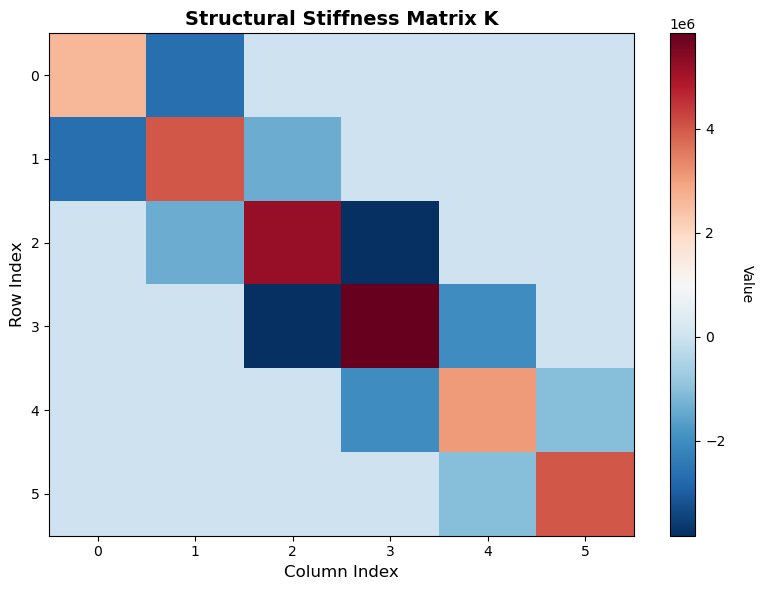

In [10]:
# Create a structural stiffness matrix
K, info = create_stiffness_matrix(n_dof=6)

print("Structural Stiffness Matrix Properties:")
print(f"  Size: {info['n_dof']} × {info['n_dof']}")
print(f"  Rank: {info['rank']}")
print(f"  Symmetric: {info['symmetric']}")
print(f"  Positive Definite: {info['positive_definite']}")
print(f"  Condition Number: {info['condition_number']:.2e}")

# Visualize the stiffness matrix
fig, ax = plot_matrix_heatmap(K, title="Structural Stiffness Matrix K",
                               annot=False, figsize=(8, 6))
plt.show()

## 1.4 Higher-Order Tensors

Tensors generalize matrices to arbitrary dimensions. A **p-th order tensor** requires **p** indices.

In [11]:
# Create a 3rd order tensor (e.g., RGB image or stress tensor)
tensor_3d = np.random.randn(4, 4, 3)  # 4×4 grid with 3 channels

print(f"3D Tensor:")
print(f"  Shape: {tensor_3d.shape}")
print(f"  Order: {tensor_3d.ndim}")
print(f"  Total elements: {tensor_3d.size}")

# Create a 4th order tensor (e.g., batch of RGB images)
tensor_4d = np.random.randn(10, 64, 64, 3)  # 10 images, 64×64 pixels, RGB

print(f"\n4D Tensor (batch of images):")
print(f"  Shape: {tensor_4d.shape}")
print(f"  Order: {tensor_4d.ndim}")
print(f"  Total elements: {tensor_4d.size}")
print(f"  Memory: {tensor_4d.nbytes / (1024**2):.2f} MB")

3D Tensor:
  Shape: (4, 4, 3)
  Order: 3
  Total elements: 48

4D Tensor (batch of images):
  Shape: (10, 64, 64, 3)
  Order: 4
  Total elements: 122880
  Memory: 0.94 MB


### 🎯 CE Example: Stress Tensor

In continuum mechanics, stress at a point is represented by a 3×3 tensor:

Stress Tensor (Pa):
[[1000000.  500000.  200000.]
 [ 500000.  800000.  100000.]
 [ 200000.  100000.  600000.]]

Is symmetric? True


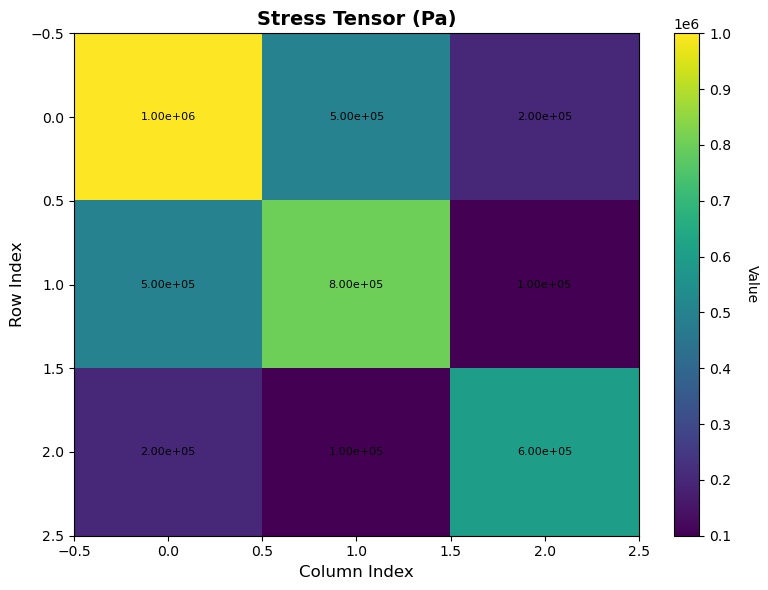

In [12]:
# Stress tensor (Pa) - symmetric for equilibrium
stress_tensor = np.array([
    [1e6,  0.5e6, 0.2e6],
    [0.5e6, 0.8e6, 0.1e6],
    [0.2e6, 0.1e6, 0.6e6]
])

print("Stress Tensor (Pa):")
print(stress_tensor)
print(f"\nIs symmetric? {np.allclose(stress_tensor, stress_tensor.T)}")

fig, ax = plot_matrix_heatmap(stress_tensor, title="Stress Tensor (Pa)",
                               cmap='viridis', fmt='.2e')
plt.show()

### 🎮 Interactive Widget: Vector Scaling

Explore how scalar multiplication scales a vector:

In [13]:
vector_scaling_widget(initial_vector=[3, 2])

interactive(children=(FloatSlider(value=1.0, description='Scale factor:', max=3.0, min=-3.0, style=SliderStyle…

# 📏 Section 2: Norms - Measuring Magnitude

Norms provide a way to measure the "size" or "magnitude" of tensors.

## 2.1 Common Norms

In [14]:
# Define a vector
v = np.array([3, 4])

# Calculate different norms
l1_norm = np.linalg.norm(v, ord=1)
l2_norm = np.linalg.norm(v, ord=2)
linf_norm = np.linalg.norm(v, ord=np.inf)

print(f"Vector v = {v}")
print(f"\nNorms:")
print(f"  L1 (Manhattan):   ||v||₁ = {l1_norm:.3f}")
print(f"  L2 (Euclidean):   ||v||₂ = {l2_norm:.3f}")
print(f"  L∞ (Max):         ||v||∞ = {linf_norm:.3f}")

# Verify L2 norm calculation
l2_manual = np.sqrt(3**2 + 4**2)
print(f"\nManual L2 calculation: √(3² + 4²) = {l2_manual:.3f} ✓")

Vector v = [3 4]

Norms:
  L1 (Manhattan):   ||v||₁ = 7.000
  L2 (Euclidean):   ||v||₂ = 5.000
  L∞ (Max):         ||v||∞ = 4.000

Manual L2 calculation: √(3² + 4²) = 5.000 ✓


## 2.2 Visualizing p-Norms

Different p-norms define different "unit balls" (sets of vectors with norm = 1):

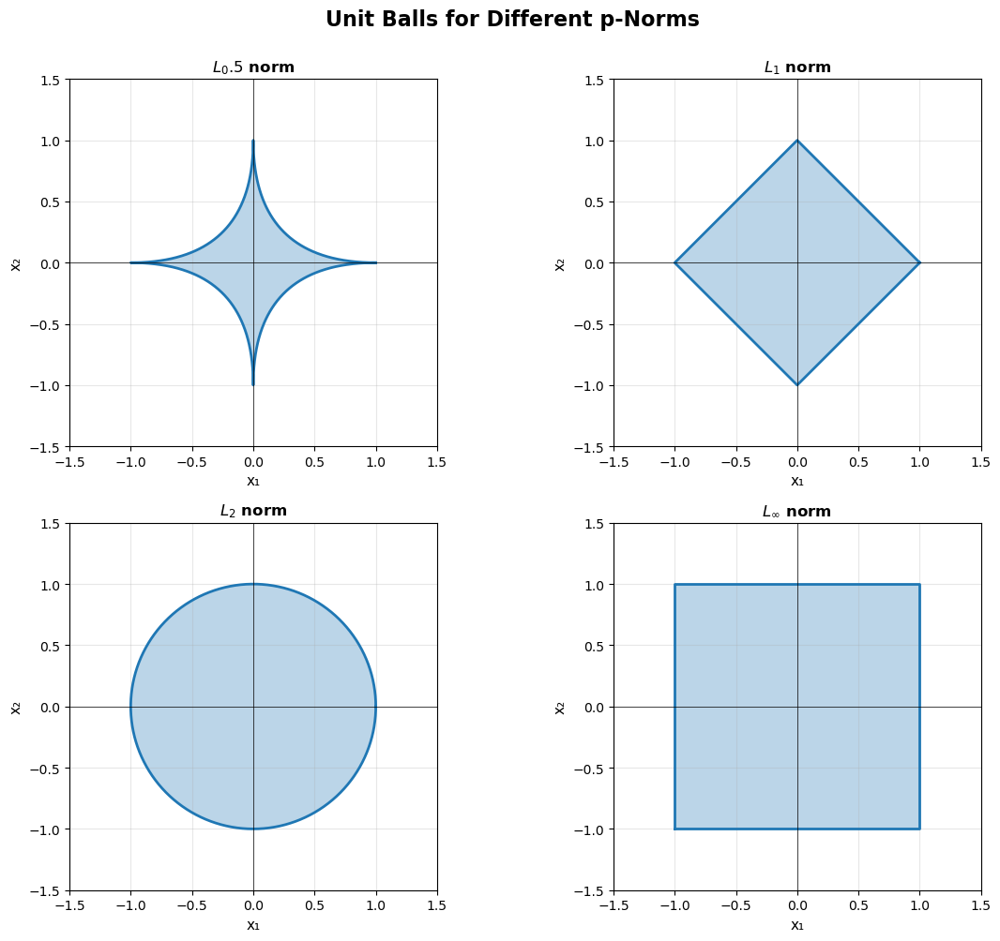

In [15]:
# Plot unit balls for different p-norms
fig, axes = plot_norm_unit_balls(p_values=[0.5, 1, 2, np.inf], figsize=(12, 10))
plt.show()

### 🎮 Interactive Widget: Norm Explorer

Explore how the unit ball changes with different p values:

In [16]:
norm_explorer_widget()

interactive(children=(FloatSlider(value=2.0, description='p value:', max=10.0, min=0.5, style=SliderStyle(desc…

### 🎯 CE Example: Error Measurement in Structural Deflection

Different norms are used to measure errors in structural analysis:

Deflection Error Analysis:
  Predicted: [2.1 3.5 4.2 3.8 2.3]
  Actual:    [2.  3.7 4.  4.1 2.5]
  Error:     [ 0.1 -0.2  0.2 -0.3 -0.2]

Error Metrics:
  L1 (total absolute error):    1.000 mm
  L2 (root mean square error):  0.469 mm
  L∞ (maximum error):           0.300 mm


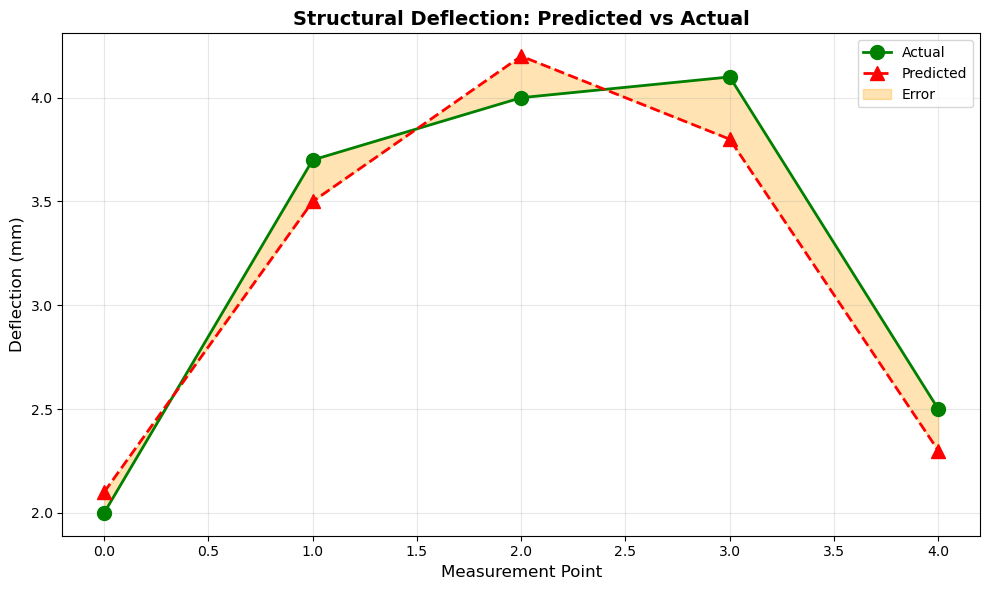

In [17]:
# Predicted vs actual deflections at 5 points (mm)
predicted = np.array([2.1, 3.5, 4.2, 3.8, 2.3])
actual = np.array([2.0, 3.7, 4.0, 4.1, 2.5])
error = predicted - actual

print("Deflection Error Analysis:")
print(f"  Predicted: {predicted}")
print(f"  Actual:    {actual}")
print(f"  Error:     {error}")
print(f"\nError Metrics:")
print(f"  L1 (total absolute error):    {np.linalg.norm(error, 1):.3f} mm")
print(f"  L2 (root mean square error):  {np.linalg.norm(error, 2):.3f} mm")
print(f"  L∞ (maximum error):           {np.linalg.norm(error, np.inf):.3f} mm")

# Visualize
fig, ax = plt.subplots(figsize=(10, 6))
x = np.arange(len(predicted))
ax.plot(x, actual, 'go-', linewidth=2, markersize=10, label='Actual')
ax.plot(x, predicted, 'r^--', linewidth=2, markersize=10, label='Predicted')
ax.fill_between(x, actual, predicted, alpha=0.3, color='orange', label='Error')
ax.set_xlabel('Measurement Point', fontsize=12)
ax.set_ylabel('Deflection (mm)', fontsize=12)
ax.set_title('Structural Deflection: Predicted vs Actual', fontsize=14, fontweight='bold')
ax.legend()
ax.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

### Edge Cases: Zero and Sparse Vectors

In [18]:
# Edge cases
zero_vector = np.zeros(5)
sparse_vector = np.array([0, 0, 5, 0, 0])
dense_vector = np.array([1, 2, 3, 4, 5])

print("Edge Cases:")
print(f"  Zero vector:   {zero_vector}, ||·||₂ = {np.linalg.norm(zero_vector):.3f}")
print(f"  Sparse vector: {sparse_vector}, ||·||₂ = {np.linalg.norm(sparse_vector):.3f}")
print(f"  Dense vector:  {dense_vector}, ||·||₂ = {np.linalg.norm(dense_vector):.3f}")

print(f"\nL0 'norm' (number of non-zero elements):")
print(f"  Zero vector:   {np.count_nonzero(zero_vector)}")
print(f"  Sparse vector: {np.count_nonzero(sparse_vector)}")
print(f"  Dense vector:  {np.count_nonzero(dense_vector)}")

Edge Cases:
  Zero vector:   [0. 0. 0. 0. 0.], ||·||₂ = 0.000
  Sparse vector: [0 0 5 0 0], ||·||₂ = 5.000
  Dense vector:  [1 2 3 4 5], ||·||₂ = 7.416

L0 'norm' (number of non-zero elements):
  Zero vector:   0
  Sparse vector: 1
  Dense vector:  5


# 💾 Section 3: Computer Memory & Floating Point

Understanding how computers store numbers is crucial for numerical computing.

## 3.1 Data Types and Memory Usage

In [19]:
# Display memory usage table
df_memory = memory_usage_table()


MEMORY USAGE FOR DIFFERENT DATA TYPES
 Data Type  Bytes  Bits            Min Value            Max Value Precision
      bool      1     8                False                 True       N/A
      int8      1     8                 -128                  127       N/A
     int16      2    16               -32768                32767       N/A
     int32      4    32          -2147483648           2147483647       N/A
     int64      8    64 -9223372036854775808  9223372036854775807       N/A
   float16      2    16             -65500.0              65500.0         3
   float32      4    32       -3.4028235e+38        3.4028235e+38         6
   float64      8    64 -1.7976931348623157e 1.7976931348623157e+        15
 complex64      8    64              Complex              Complex         6
complex128     16   128              Complex              Complex        15

Memory for 1 million elements:
   bool      :     0.95 MB
   int8      :     0.95 MB
   int16     :     1.91 MB
   int32    

## 3.2 IEEE 754 Floating-Point Representation

Floating-point numbers are stored as: **(-1)^S × (1.Mantissa) × 2^Exponent**

In [20]:
# Demonstrate floating-point precision issues
results = demonstrate_floating_point()

FLOATING-POINT ARITHMETIC DEMONSTRATION

1. Machine Epsilon (smallest ε where 1 + ε ≠ 1):
   float32: 1.19e-07
   float64: 2.22e-16

2. Precision Limits (does 1 + x equal 1?):
   float32:
      1.0 + 1e-7: False
      1.0 + 1e-8: True
   float64:
      1.0 + 1e-15: False
      1.0 + 1e-16: True
      1.0 + 1e-17: True

3. Catastrophic Cancellation:
   a = 1.0, b = 9.99999993922529e-09
   (a + b) - a = 0.0
   Expected: 9.99999993922529e-09
   Relative error: 100.00%

4. Associativity Failure:
   (1e20 + 1.0) + (-1e20) = 0.0
   1e20 + (1.0 + (-1e20)) = 0.0
   Are they equal? True



### Key Takeaways:

1. **Machine epsilon** is the smallest number ε where `1 + ε ≠ 1`
2. **Catastrophic cancellation** occurs when subtracting nearly equal numbers
3. **Associativity fails** for floating-point arithmetic
4. Always be aware of **precision limits** when doing numerical computations

### 🎯 Stress Test: Large Matrix Memory

In [21]:
# Estimate memory for large matrices
sizes = [100, 1000, 10000, 100000]
dtypes = [np.float32, np.float64]

print("Memory Requirements for Square Matrices:\n")
print(f"{'Size':>10} {'float32':>15} {'float64':>15}")
print("-" * 42)

for n in sizes:
    mem_32 = (n * n * 4) / (1024**2)  # 4 bytes per float32
    mem_64 = (n * n * 8) / (1024**2)  # 8 bytes per float64
    
    if mem_32 < 1:
        str_32 = f"{mem_32*1024:.2f} KB"
    elif mem_32 < 1024:
        str_32 = f"{mem_32:.2f} MB"
    else:
        str_32 = f"{mem_32/1024:.2f} GB"
    
    if mem_64 < 1:
        str_64 = f"{mem_64*1024:.2f} KB"
    elif mem_64 < 1024:
        str_64 = f"{mem_64:.2f} MB"
    else:
        str_64 = f"{mem_64/1024:.2f} GB"
    
    print(f"{n:>10} {str_32:>15} {str_64:>15}")

Memory Requirements for Square Matrices:

      Size         float32         float64
------------------------------------------
       100        39.06 KB        78.12 KB
      1000         3.81 MB         7.63 MB
     10000       381.47 MB       762.94 MB
    100000        37.25 GB        74.51 GB


# 🎯 Section 4: Projections

Projection is a fundamental operation that decomposes a vector into components.

## 4.1 Vector-to-Vector Projection

The projection of vector **x** onto vector **w** is:

$$\text{proj}_\mathbf{w}(\mathbf{x}) = \frac{\mathbf{w}^T \mathbf{x}}{\mathbf{w}^T \mathbf{w}} \mathbf{w}$$

In [22]:
# Calculate projection
x = np.array([3, 2])
w = np.array([2, 1])

proj = (np.dot(x, w) / np.dot(w, w)) * w
perp = x - proj

print(f"Vector x = {x}")
print(f"Vector w = {w}")
print(f"\nProjection of x onto w: {proj}")
print(f"Perpendicular component: {perp}")
print(f"\nVerification:")
print(f"  proj + perp = {proj + perp} (should equal x)")
print(f"  proj · perp = {np.dot(proj, perp):.10f} (should be ≈ 0)")

Vector x = [3 2]
Vector w = [2 1]

Projection of x onto w: [3.2 1.6]
Perpendicular component: [-0.2  0.4]

Verification:
  proj + perp = [3. 2.] (should equal x)
  proj · perp = -0.0000000000 (should be ≈ 0)


### 🎮 Interactive Widget: Projection Explorer

In [23]:
projection_widget(vector_x=[3, 2], vector_w=[2, 1])

interactive(children=(FloatSlider(value=3.0, description='x₁:', max=5.0, min=-5.0, step=0.5), FloatSlider(valu…

### 📽️ Animation: Vector Projection

In [24]:
# Animate the projection process
anim = animate_projection(vector=[4, 3], onto_vector=[3, 1], n_frames=60)
display(anim)

### 🎯 CE Example: Force Decomposition on Beam

Decompose a force into axial and transverse components:

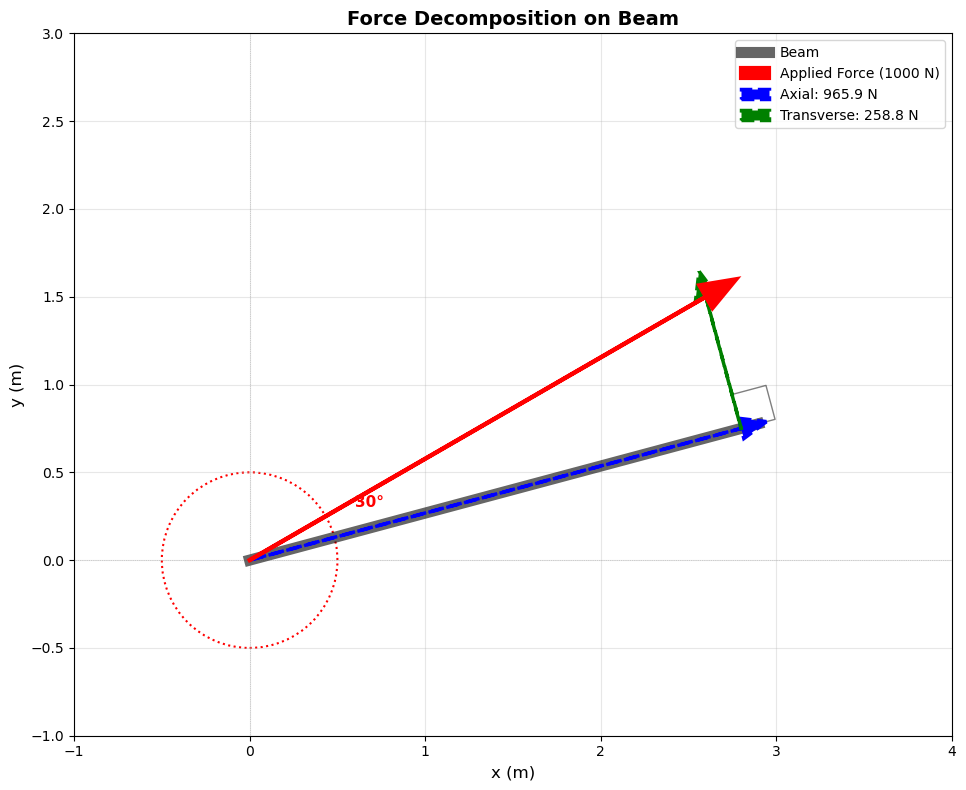


Force Components:
  Applied force:      [866.02540378 500.        ]
  Axial component:    [933.01270189 250.        ] (965.9 N)
  Transverse component: [-66.98729811 250.        ] (258.8 N)


In [25]:
# Force decomposition
fig, ax, components = create_force_decomposition(
    force_magnitude=1000,  # N
    force_angle_deg=30,    # degrees
    beam_angle_deg=15      # degrees
)
plt.show()

print("\nForce Components:")
print(f"  Applied force:      {components['force']}")
print(f"  Axial component:    {components['axial']} ({components['axial_magnitude']:.1f} N)")
print(f"  Transverse component: {components['transverse']} ({components['transverse_magnitude']:.1f} N)")

## 4.2 Matrix Projection (Pseudo-Inverse)

The projection matrix onto the column space of **A** is:

$$\mathbf{P} = \mathbf{A}(\mathbf{A}^T\mathbf{A})^{-1}\mathbf{A}^T$$

In [26]:
# Projection onto column space
A = np.array([[1, 0],
              [1, 1],
              [0, 1]])
y = np.array([1, 2, 1])

# Calculate projection matrix
P = A @ np.linalg.inv(A.T @ A) @ A.T

# Project y onto column space of A
y_proj = P @ y

print(f"Matrix A (3×2):\n{A}\n")
print(f"Vector y: {y}\n")
print(f"Projection matrix P (3×3):\n{P}\n")
print(f"Projected vector: {y_proj}")
print(f"\nVerification: P² = P (idempotent)?")
print(np.allclose(P @ P, P))

Matrix A (3×2):
[[1 0]
 [1 1]
 [0 1]]

Vector y: [1 2 1]

Projection matrix P (3×3):
[[ 0.66666667  0.33333333 -0.33333333]
 [ 0.33333333  0.66666667  0.33333333]
 [-0.33333333  0.33333333  0.66666667]]

Projected vector: [1. 2. 1.]

Verification: P² = P (idempotent)?
True


# 🔢 Section 5: Matrix Rank

The **rank** of a matrix is the number of linearly independent rows or columns.

In [27]:
# Full rank matrix
A_full = np.array([[1, 0, 2],
                   [0, 1, 3],
                   [2, 3, 1]])

# Rank-deficient matrix
A_deficient = np.array([[1, 2, 3],
                        [2, 4, 6],
                        [3, 6, 9]])

rank_full = np.linalg.matrix_rank(A_full)
rank_def = np.linalg.matrix_rank(A_deficient)

print("Matrix Rank Examples:")
print(f"\nFull-rank matrix (3×3):")
print(A_full)
print(f"Rank: {rank_full}")

print(f"\nRank-deficient matrix (3×3):")
print(A_deficient)
print(f"Rank: {rank_def}")
print(f"Notice: Row 2 = 2×Row 1, Row 3 = 3×Row 1")

Matrix Rank Examples:

Full-rank matrix (3×3):
[[1 0 2]
 [0 1 3]
 [2 3 1]]
Rank: 3

Rank-deficient matrix (3×3):
[[1 2 3]
 [2 4 6]
 [3 6 9]]
Rank: 1
Notice: Row 2 = 2×Row 1, Row 3 = 3×Row 1


### 🎯 CE Example: Structural Indeterminacy Detection

In structural analysis, rank deficiency indicates indeterminacy:

In [28]:
# Determinate structure (full rank)
K_determinate = np.array([
    [ 2, -1,  0],
    [-1,  2, -1],
    [ 0, -1,  1]
])

# Indeterminate structure (rank deficient - missing support)
K_indeterminate = np.array([
    [ 1, -1,  0],
    [-1,  2, -1],
    [ 0, -1,  1]
])

print("Structural Stiffness Analysis:")
print(f"\nDeterminate structure:")
print(K_determinate)
print(f"Rank: {np.linalg.matrix_rank(K_determinate)} (full rank)")
print(f"Determinant: {np.linalg.det(K_determinate):.2e}")

print(f"\nIndeterminate structure:")
print(K_indeterminate)
print(f"Rank: {np.linalg.matrix_rank(K_indeterminate)} (rank deficient!)")
print(f"Determinant: {np.linalg.det(K_indeterminate):.2e}")
print("⚠️ This structure has a rigid body mode (can move without deformation)")

Structural Stiffness Analysis:

Determinate structure:
[[ 2 -1  0]
 [-1  2 -1]
 [ 0 -1  1]]
Rank: 3 (full rank)
Determinant: 1.00e+00

Indeterminate structure:
[[ 1 -1  0]
 [-1  2 -1]
 [ 0 -1  1]]
Rank: 2 (rank deficient!)
Determinant: 0.00e+00
⚠️ This structure has a rigid body mode (can move without deformation)


### Rank and Data Quality

In ML, low rank can indicate:
- **Redundant features** (high correlation)
- **Data quality issues**
- **Opportunities for dimensionality reduction**

In [29]:
# Create a dataset with redundant features
np.random.seed(42)
n_samples = 100

# Independent features
feature1 = np.random.randn(n_samples)
feature2 = np.random.randn(n_samples)

# Redundant feature (linear combination)
feature3 = 2 * feature1 + 3 * feature2 + 0.01 * np.random.randn(n_samples)

X = np.column_stack([feature1, feature2, feature3])

print("Dataset with Redundant Features:")
print(f"Shape: {X.shape}")
print(f"Rank: {np.linalg.matrix_rank(X)}")
print(f"Expected rank: 2 (feature3 ≈ 2×feature1 + 3×feature2)")

# Correlation matrix
corr = np.corrcoef(X.T)
print(f"\nCorrelation matrix:")
print(corr)

Dataset with Redundant Features:
Shape: (100, 3)
Rank: 3
Expected rank: 2 (feature3 ≈ 2×feature1 + 3×feature2)

Correlation matrix:
[[ 1.         -0.13642221  0.44998929]
 [-0.13642221  1.          0.82329002]
 [ 0.44998929  0.82329002  1.        ]]


# ⚖️ Section 6: Conditioning

**Conditioning** measures how sensitive a problem is to small changes in input.

## 6.1 Condition Number

The condition number is defined as:

$$\kappa(\mathbf{A}) = ||\mathbf{A}||_2 \cdot ||\mathbf{A}^{-1}||_2$$

- **κ ≈ 1**: Well-conditioned
- **κ >> 1**: Ill-conditioned

In [30]:
# Well-conditioned matrix
A_good = np.array([[2, 1],
                   [1, 2]])

# Ill-conditioned matrix
A_bad = np.array([[1, 1],
                  [1, 1.0001]])

cond_good = np.linalg.cond(A_good)
cond_bad = np.linalg.cond(A_bad)

print("Condition Number Examples:")
print(f"\nWell-conditioned matrix:")
print(A_good)
print(f"κ(A) = {cond_good:.2f}")

print(f"\nIll-conditioned matrix:")
print(A_bad)
print(f"κ(A) = {cond_bad:.2e}")

Condition Number Examples:

Well-conditioned matrix:
[[2 1]
 [1 2]]
κ(A) = 3.00

Ill-conditioned matrix:
[[1.     1.    ]
 [1.     1.0001]]
κ(A) = 4.00e+04


## 6.2 Effect of Ill-Conditioning

In [31]:
# Demonstrate ill-conditioning effects
results = condition_number_demo(matrix_type='hilbert', size=5)


CONDITION NUMBER DEMONSTRATION (HILBERT MATRIX)

Matrix size: 5 × 5
Condition number: 4.77e+05

Relative input error (||δb|| / ||b||): 4.43e-11
Relative output error (||δx|| / ||x||): 5.27e-07
Amplification factor: 11895.37
Theoretical bound (κ × input error): 2.11e-05

Interpretation:
   ✗ Ill-conditioned: Small input errors → large output errors!


### 🎮 Interactive Widget: Conditioning Explorer

In [32]:
condition_number_widget()

interactive(children=(FloatSlider(value=10.0, description='Scale Ratio:', min=1.0, step=1.0, style=SliderStyle…

### 🎯 CE Example: Feature Scaling

Unscaled features can lead to ill-conditioned problems:

In [33]:
# Unscaled features
np.random.seed(42)
n_samples = 100

# Feature 1: in range [0, 1]
feature1_unscaled = np.random.rand(n_samples)

# Feature 2: in range [0, 1000]
feature2_unscaled = np.random.rand(n_samples) * 1000

X_unscaled = np.column_stack([feature1_unscaled, feature2_unscaled])

# Add intercept
X_unscaled = np.column_stack([np.ones(n_samples), X_unscaled])

# Scaled features (standardization)
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_unscaled[:, 1:])
X_scaled = np.column_stack([np.ones(n_samples), X_scaled])

# Condition numbers
cond_unscaled = np.linalg.cond(X_unscaled.T @ X_unscaled)
cond_scaled = np.linalg.cond(X_scaled.T @ X_scaled)

print("Feature Scaling Impact:")
print(f"\nUnscaled features:")
print(f"  Feature 1 range: [{feature1_unscaled.min():.2f}, {feature1_unscaled.max():.2f}]")
print(f"  Feature 2 range: [{feature2_unscaled.min():.2f}, {feature2_unscaled.max():.2f}]")
print(f"  Condition number: {cond_unscaled:.2e}")

print(f"\nScaled features:")
print(f"  Feature 1 range: [{X_scaled[:, 1].min():.2f}, {X_scaled[:, 1].max():.2f}]")
print(f"  Feature 2 range: [{X_scaled[:, 2].min():.2f}, {X_scaled[:, 2].max():.2f}]")
print(f"  Condition number: {cond_scaled:.2e}")

print(f"\n✓ Improvement: {cond_unscaled / cond_scaled:.1f}× better conditioned!")

Feature Scaling Impact:

Unscaled features:
  Feature 1 range: [0.01, 0.99]
  Feature 2 range: [6.95, 985.65]
  Condition number: 5.02e+06

Scaled features:
  Feature 1 range: [-1.57, 1.75]
  Feature 2 range: [-1.68, 1.67]
  Condition number: 1.07e+00

✓ Improvement: 4693147.6× better conditioned!


# 🌊 Section 7: Eigenvalue Decomposition

Eigenvalues and eigenvectors reveal the "principal directions" of a transformation.

## 7.1 Eigenvalues and Eigenvectors

For a square matrix **A**, if:

$$\mathbf{A}\mathbf{v} = \lambda\mathbf{v}$$

then **v** is an **eigenvector** and **λ** is an **eigenvalue**.

In [34]:
# Example matrix
A = np.array([[4, 1],
              [2, 3]])

# Compute eigenvalues and eigenvectors
eigenvalues, eigenvectors = np.linalg.eig(A)

print("Matrix A:")
print(A)
print(f"\nEigenvalues: {eigenvalues}")
print(f"\nEigenvectors:")
print(eigenvectors)

# Verify: A*v = λ*v
for i in range(len(eigenvalues)):
    v = eigenvectors[:, i]
    lam = eigenvalues[i]
    Av = A @ v
    lam_v = lam * v
    
    print(f"\nEigenvector {i+1}:")
    print(f"  A*v = {Av}")
    print(f"  λ*v = {lam_v}")
    print(f"  Equal? {np.allclose(Av, lam_v)}")

Matrix A:
[[4 1]
 [2 3]]

Eigenvalues: [5. 2.]

Eigenvectors:
[[ 0.70710678 -0.4472136 ]
 [ 0.70710678  0.89442719]]

Eigenvector 1:
  A*v = [3.53553391 3.53553391]
  λ*v = [3.53553391 3.53553391]
  Equal? True

Eigenvector 2:
  A*v = [-0.89442719  1.78885438]
  λ*v = [-0.89442719  1.78885438]
  Equal? True


### 📽️ Animation: Eigenvalue Transformation

In [35]:
A_transform = np.array([[2, 1],
                        [1, 2]])

anim = animate_eigen_transform(A_transform, n_frames=120)
display(anim)

### 🎯 CE Example: Structural Vibration Modes

Eigenvalues give natural frequencies, eigenvectors give mode shapes:

In [36]:
# Create a 3-mass vibration system
M, K, eigenvalues, eigenvectors, frequencies = create_vibration_system(
    n_masses=3,
    mass_values=np.array([1000, 1000, 1000]),  # kg
    k_values=np.array([1e6, 1e6, 1e6, 1e6])    # N/m
)

print("Vibration System Analysis:")
print(f"\nMass matrix M (kg):")
print(M)
print(f"\nStiffness matrix K (N/m):")
print(K)

print(f"\nNatural Frequencies:")
for i, freq in enumerate(frequencies):
    print(f"  Mode {i+1}: {freq:.2f} Hz (ω² = {eigenvalues[i]:.2e})")

print(f"\nMode Shapes (eigenvectors):")
print(eigenvectors)

Vibration System Analysis:

Mass matrix M (kg):
[[1000    0    0]
 [   0 1000    0]
 [   0    0 1000]]

Stiffness matrix K (N/m):
[[ 2000000. -1000000.        0.]
 [-1000000.  2000000. -1000000.]
 [       0. -1000000.  2000000.]]

Natural Frequencies:
  Mode 1: 3.85 Hz (ω² = 5.86e+02)
  Mode 2: 7.12 Hz (ω² = 2.00e+03)
  Mode 3: 9.30 Hz (ω² = 3.41e+03)

Mode Shapes (eigenvectors):
[[ 5.00000000e-01 -7.07106781e-01 -5.00000000e-01]
 [ 7.07106781e-01  2.93014398e-16  7.07106781e-01]
 [ 5.00000000e-01  7.07106781e-01 -5.00000000e-01]]


### 📽️ Animation: Vibration Mode Shapes

In [37]:
# Animate first mode
anim_mode1 = simulate_structural_modes(eigenvectors, n_frames=100, mode_index=0)
display(anim_mode1)

In [38]:
# Animate second mode
anim_mode2 = simulate_structural_modes(eigenvectors, n_frames=100, mode_index=1)
display(anim_mode2)

# 🔍 Section 8: Singular Value Decomposition (SVD)

SVD generalizes eigendecomposition to **rectangular** matrices.

## 8.1 SVD Decomposition

Any matrix **A** (m×n) can be decomposed as:

$$\mathbf{A} = \mathbf{U} \mathbf{\Sigma} \mathbf{V}^T$$

where:
- **U**: Left singular vectors (m×m, orthonormal)
- **Σ**: Singular values (m×n, diagonal)
- **V**: Right singular vectors (n×n, orthonormal)

In [39]:
# Example matrix
A = np.array([[3, 1, 1],
              [1, 3, 1]])

# Compute SVD
U, s, Vt = np.linalg.svd(A, full_matrices=False)

print("Matrix A (2×3):")
print(A)
print(f"\nLeft singular vectors U (2×2):")
print(U)
print(f"\nSingular values s:")
print(s)
print(f"\nRight singular vectors V^T (2×3):")
print(Vt)

# Reconstruct A
A_reconstructed = U @ np.diag(s) @ Vt
print(f"\nReconstructed A:")
print(A_reconstructed)
print(f"Reconstruction error: {np.linalg.norm(A - A_reconstructed):.2e}")

Matrix A (2×3):
[[3 1 1]
 [1 3 1]]

Left singular vectors U (2×2):
[[-0.70710678 -0.70710678]
 [-0.70710678  0.70710678]]

Singular values s:
[4.24264069 2.        ]

Right singular vectors V^T (2×3):
[[-6.66666667e-01 -6.66666667e-01 -3.33333333e-01]
 [-7.07106781e-01  7.07106781e-01  8.78215503e-17]]

Reconstructed A:
[[3. 1. 1.]
 [1. 3. 1.]]
Reconstruction error: 1.27e-15


## 8.2 SVD and Eigenvalues

The singular values are related to eigenvalues:

$$\sigma_i^2 = \lambda_i(\mathbf{A}^T\mathbf{A})$$

In [40]:
# Verify relationship
ATA = A.T @ A
eigenvalues_ATA, _ = np.linalg.eig(ATA)
eigenvalues_ATA = np.sort(eigenvalues_ATA)[::-1]

print("Relationship between singular values and eigenvalues:")
print(f"\nSingular values (σ):        {s}")
print(f"σ²:                          {s**2}")
print(f"Eigenvalues of A^T A:        {eigenvalues_ATA[:len(s)]}")
print(f"Match? {np.allclose(s**2, eigenvalues_ATA[:len(s)])}")

Relationship between singular values and eigenvalues:

Singular values (σ):        [4.24264069 2.        ]
σ²:                          [18.  4.]
Eigenvalues of A^T A:        [18.  4.]
Match? True


### 🎯 Application: Image Compression with SVD

Image shape: (100, 100)
Image size: 10000 pixels


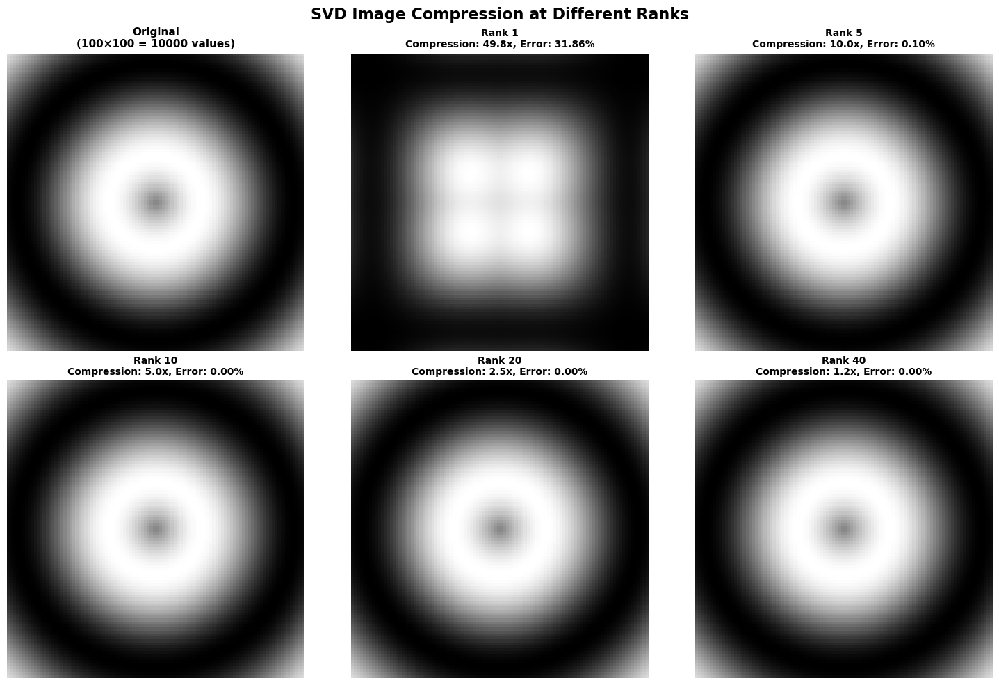

In [41]:
# Download a sample image
import urllib.request
from PIL import Image as PILImage
import io

# Create a simple synthetic image
img_size = 100
x = np.linspace(-5, 5, img_size)
y = np.linspace(-5, 5, img_size)
X, Y = np.meshgrid(x, y)
Z = np.sin(np.sqrt(X**2 + Y**2))
image_array = (Z - Z.min()) / (Z.max() - Z.min()) * 255

print(f"Image shape: {image_array.shape}")
print(f"Image size: {image_array.size} pixels")

# Plot SVD compression
fig, axes = plot_svd_compression(image_array, ranks=[1, 5, 10, 20, 40], figsize=(15, 10))
plt.show()

### 🎮 Interactive Widget: SVD Rank Explorer

In [42]:
svd_rank_widget(image_array)

interactive(children=(IntSlider(value=20, description='Rank:', min=1, style=SliderStyle(description_width='ini…

### 🎯 CE Example: Sensor Data Compression

In structural health monitoring, SVD can compress sensor data:

Sensor Data Shape: (100, 10)
  100 time steps
  10 sensors


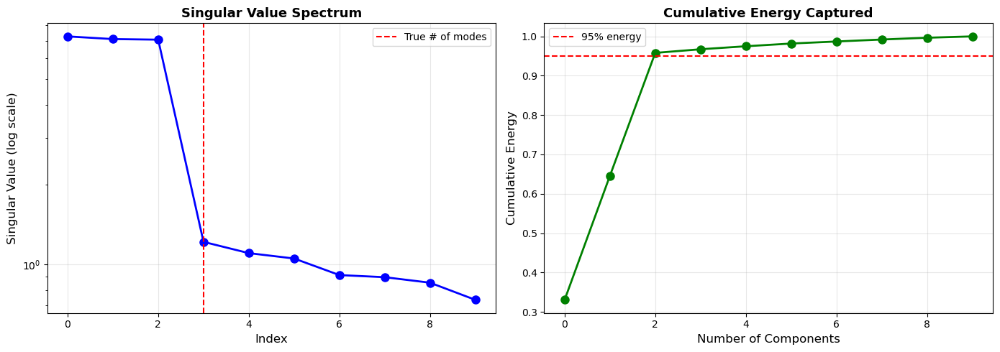


Energy Analysis:
  Top 3 singular values capture 95.8% of energy
  Top 5 singular values capture 97.5% of energy


In [43]:
# Generate synthetic sensor data
sensor_data, true_modes = generate_sensor_data(
    n_sensors=10,
    n_timesteps=100,
    n_modes=3,
    noise_level=0.1
)

print(f"Sensor Data Shape: {sensor_data.shape}")
print(f"  {sensor_data.shape[0]} time steps")
print(f"  {sensor_data.shape[1]} sensors")

# Perform SVD
U, s, Vt = np.linalg.svd(sensor_data, full_matrices=False)

# Plot singular value spectrum
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Singular values
axes[0].semilogy(s, 'bo-', linewidth=2, markersize=8)
axes[0].set_xlabel('Index', fontsize=12)
axes[0].set_ylabel('Singular Value (log scale)', fontsize=12)
axes[0].set_title('Singular Value Spectrum', fontsize=13, fontweight='bold')
axes[0].grid(True, alpha=0.3)
axes[0].axvline(x=3, color='r', linestyle='--', label='True # of modes')
axes[0].legend()

# Cumulative energy
cumulative_energy = np.cumsum(s**2) / np.sum(s**2)
axes[1].plot(cumulative_energy, 'go-', linewidth=2, markersize=8)
axes[1].axhline(y=0.95, color='r', linestyle='--', label='95% energy')
axes[1].set_xlabel('Number of Components', fontsize=12)
axes[1].set_ylabel('Cumulative Energy', fontsize=12)
axes[1].set_title('Cumulative Energy Captured', fontsize=13, fontweight='bold')
axes[1].grid(True, alpha=0.3)
axes[1].legend()

plt.tight_layout()
plt.show()

print(f"\nEnergy Analysis:")
print(f"  Top 3 singular values capture {cumulative_energy[2]:.1%} of energy")
print(f"  Top 5 singular values capture {cumulative_energy[4]:.1%} of energy")

# 📚 Section 9: Summary & Key Takeaways

### 1. **Tensors**
- Scalars (0D) → Vectors (1D) → Matrices (2D) → Higher-order tensors
- Operations: addition, multiplication, dot product
- CE Application: Stiffness matrices, stress tensors

### 2. **Norms**
- L1 (Manhattan), L2 (Euclidean), L∞ (Max)
- Different norms for different applications
- CE Application: Error measurement in structural analysis

### 3. **Computer Memory**
- IEEE 754 floating-point representation
- Machine epsilon and precision limits
- Memory usage for different data types

### 4. **Projections**
- Vector-to-vector projection
- Matrix projection (pseudo-inverse)
- CE Application: Force decomposition

### 5. **Rank**
- Linear independence of rows/columns
- Full rank vs rank deficient
- CE Application: Structural indeterminacy

### 6. **Conditioning**
- Condition number κ(A)
- Well-conditioned vs ill-conditioned
- CE Application: Feature scaling

### 7. **Eigenvalue Decomposition**
- Eigenvalues and eigenvectors
- Principal directions of transformation
- CE Application: Structural vibration modes

### 8. **Singular Value Decomposition**
- Generalization to rectangular matrices
- Image compression
- CE Application: Sensor data compression

## 🔗 Connections to Machine Learning

| Linear Algebra Concept | ML Application |
|------------------------|----------------|
| Vectors | Feature vectors, embeddings |
| Matrices | Datasets, weight matrices |
| Norms | Loss functions, regularization |
| Projections | Dimensionality reduction (PCA) |
| Rank | Feature redundancy detection |
| Conditioning | Training stability, convergence |
| Eigenvalues | PCA, spectral clustering |
| SVD | Recommender systems, LSA |

## 📖 Further Reading

1. **Books:**
   - *Linear Algebra and Its Applications* by Gilbert Strang
   - *Matrix Computations* by Golub & Van Loan
   - *Deep Learning* by Goodfellow, Bengio & Courville (Chapter 2)

2. **Online Resources:**
   - MIT OCW: Linear Algebra (18.06)
   - 3Blue1Brown: Essence of Linear Algebra (YouTube)
   - NumPy Linear Algebra Documentation

3. **Practice:**
   - Implement PCA from scratch using SVD
   - Solve structural analysis problems using eigendecomposition
   - Experiment with different norms in regression problems

## 🎓 Review Questions

1. What is the difference between a vector and a matrix?
2. Why do we care about data types in numerical computing?
3. What does the L2 norm measure?
4. How does projection relate to the pseudo-inverse?
5. What does a low-rank matrix indicate about your dataset?
6. Why is feature scaling important for conditioning?
7. What do eigenvalues represent in a vibration problem?
8. How does SVD differ from eigendecomposition?

# 🎉 Congratulations!

You've completed the Linear Algebra for ML notebook. You should now have a solid understanding of:
- Tensor operations and their computational aspects
- How to measure and compare tensors using norms
- The importance of numerical precision and conditioning
- Advanced decompositions (eigenvalues, SVD) and their applications

**Next Lecture:** Probability & Statistics

---

*Notebook created for CE639: AI for Civil Engineering*  
*IIT Gandhinagar*